# Gọi thư viện cần thiết 

In [10]:
import numpy as np
from PIL import Image, ImageFont, ImageDraw
from PIL.ImageChops import add, subtract, multiply, difference, screen
import PIL.ImageStat as stat
from skimage.io import imread, imsave, imshow, show, imread_collection, imshow_collection
from skimage import color, exposure, img_as_float, data
from skimage.transform import SimilarityTransform, warp, swirl
from skimage.util import invert, random_noise, montage
import matplotlib.image as mpimg
import matplotlib.pylab as plt
from scipy.ndimage import affine_transform, zoom
from scipy import misc

# Harris Corner Detector

Ảnh ban đầu 

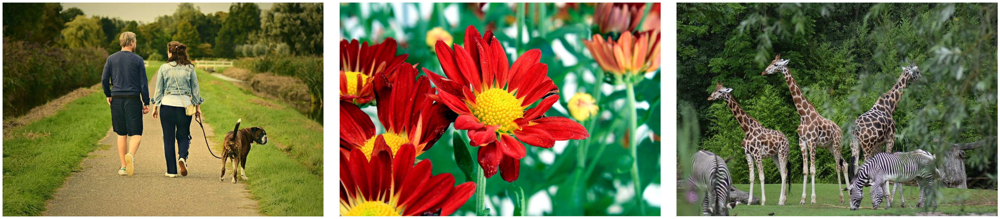

In [11]:
from PIL import Image
import matplotlib.pyplot as plt

# Đường dẫn đến các bức ảnh
img_paths = ["/kaggle/input/data-btl-xla/images/men_dog.jpg",
             "/kaggle/input/data-btl-xla/images/flowers.jpg",
             "/kaggle/input/data-btl-xla/images/giraffe_zebra.jpg"]

# Tạo một cửa sổ hiển thị với kích thước lớn
plt.figure(figsize=(50, 30))

# Vòng lặp qua từng ảnh
for i, path in enumerate(img_paths):
    # Mở ảnh 
    img = Image.open(path)
    
    # Tạo một subplot cho mỗi bức ảnh
    plt.subplot(1, 3, i + 1)
    
    # Hiển thị bức ảnh
    plt.imshow(img)
    
    # Tắt hiển thị trục tọa độ x và y để ảnh nhìn đẹp hơn
    plt.axis('off')

# Điều chỉnh khoảng cách giữa các subplot
plt.subplots_adjust(wspace=0.05, hspace=0.05)

# Hiển thị tất cả các bức ảnh trong cửa sổ
plt.show()

Ảnh sau xử lý 

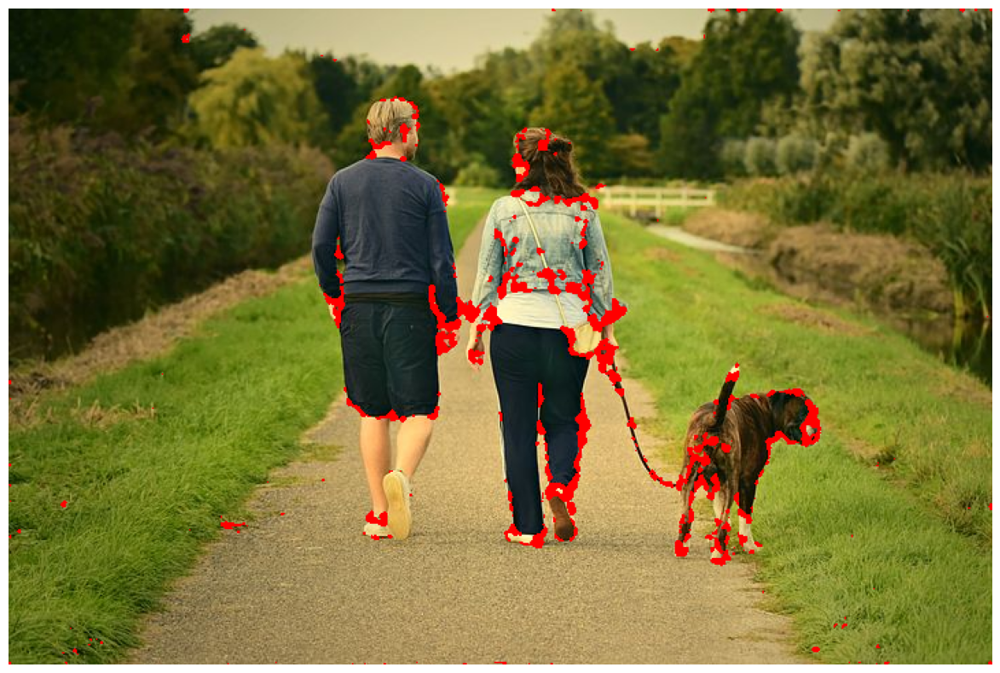

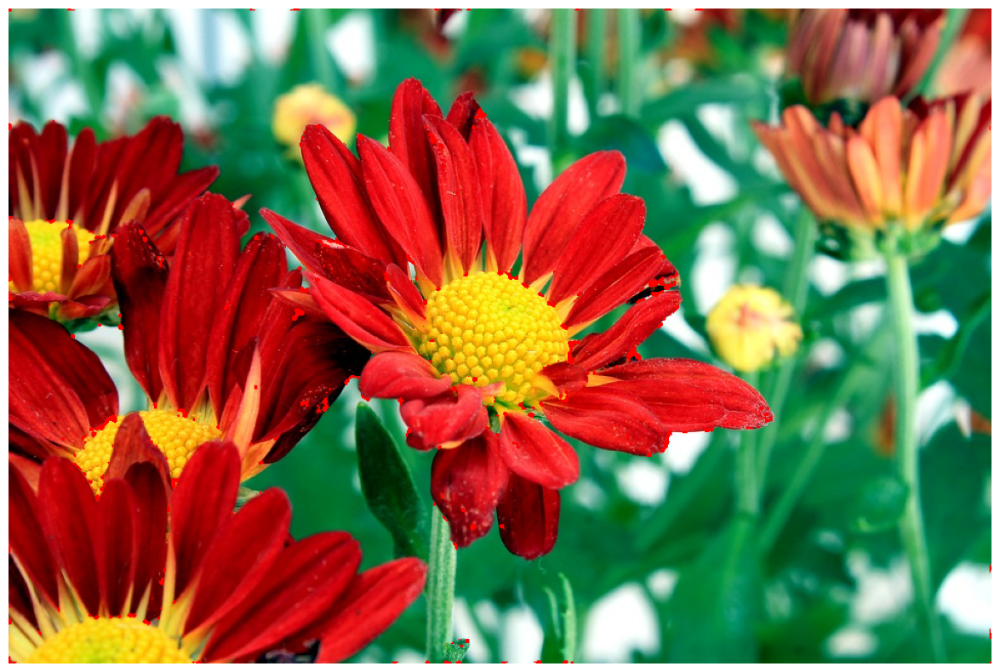

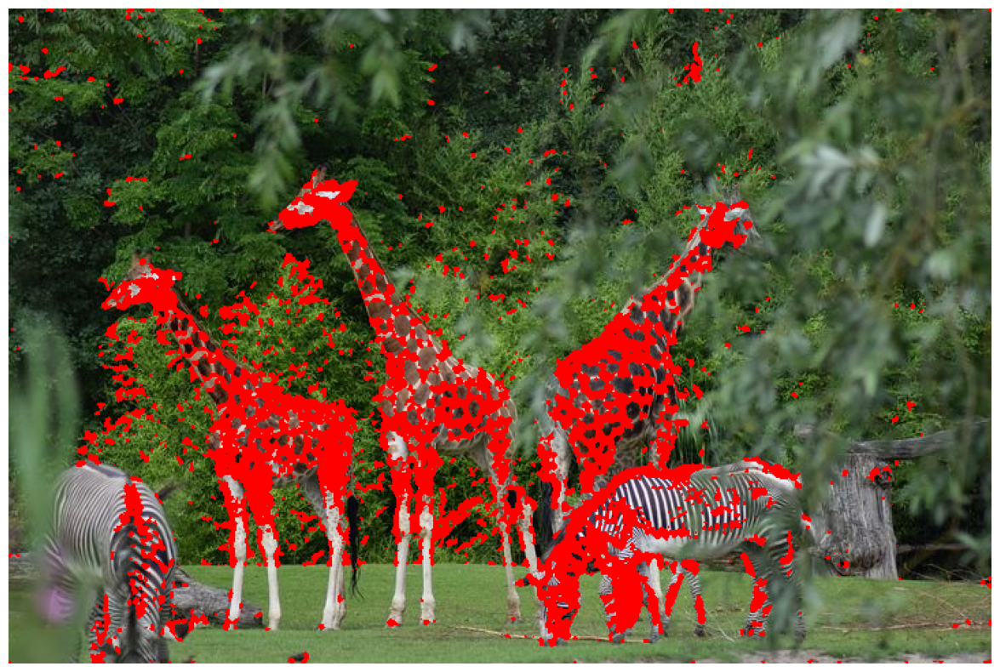

In [12]:
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
from skimage.feature import corner_harris
from skimage.color import rgb2gray
from skimage.io import imread

# Đường dẫn đến các bức ảnh
img_paths = ["/kaggle/input/data-btl-xla/images/men_dog.jpg",
             "/kaggle/input/data-btl-xla/images/flowers.jpg",
             "/kaggle/input/data-btl-xla/images/giraffe_zebra.jpg"]

# Vòng lặp qua từng ảnh
for path in img_paths:
    # Đọc ảnh và chuyển đổi thành định dạng RGB
    img = np.array(Image.open(path).convert('RGB'))
    
    # Chuyển đổi ảnh RGB thành ảnh grayscale
    image_gray = rgb2gray(img)

    # Tính toán các tọa độ góc sử dụng phép dò góc Harris
    coordinates = corner_harris(image_gray, k=0.001)

    # Đánh dấu các điểm góc với ngưỡng trên ảnh RGB
    img[coordinates > 0.01 * coordinates.max()] = [255, 0, 0]  # Đánh dấu màu đỏ

    # Hiển thị ảnh với các điểm góc được đánh dấu
    plt.figure(figsize=(20, 10))
    plt.imshow(img)
    plt.axis('off')  # Tắt trục tọa độ để ảnh nhìn đẹp hơn
    plt.show()


# Robust image matching using the RANSAC algorithm and Harris Corner features

Ảnh ban đầu 

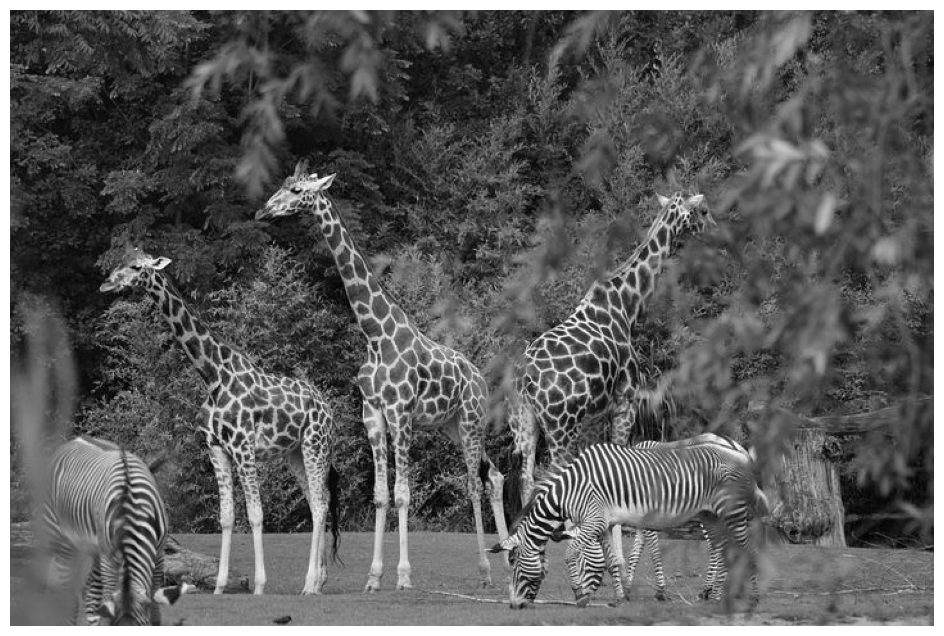

In [13]:
from PIL import Image
import matplotlib.pyplot as plt

# Đường dẫn đến bức ảnh đầu tiên
img_path = "/kaggle/input/data-btl-xla/images/giraffe_zebra.jpg"

# Mở ảnh và chuyển đổi thành ảnh grayscale
img = Image.open(img_path).convert('L')  # Chuyển thành ảnh xám

# Tạo một cửa sổ hiển thị với kích thước lớn
plt.figure(figsize=(12, 8))

# Hiển thị bức ảnh xám
plt.imshow(img, cmap='gray')  # Đặt `cmap='gray'` để hiển thị ảnh xám

# Tắt hiển thị trục tọa độ x và y để ảnh nhìn đẹp hơn
plt.axis('off')

# Hiển thị ảnh
plt.show()

Ảnh sau xử lý 

/tmp/ipykernel_30/761291422.py:52: RuntimeWarning: invalid value encountered in cast
  row, col = np.round(coordinates).astype(np.intp)
/tmp/ipykernel_30/761291422.py:53: RuntimeWarning: overflow encountered in scalar subtract
  window_original = image_original[row-window_ext:row+window_ext+1, col-window_ext:col+window_ext+1, :]


Tham số biến đổi affine ban đầu:
Scale: [0.8 0.9], Translation: [120. -20.], Rotation: 0.09999999999999999
Mô hình biến đổi ước lượng:
Scale: [0.9347344  0.82775853], Translation: [-26.43248522 105.66810396], Rotation: -0.07995345206946747
Mô hình biến đổi RANSAC:
Scale: [0.93514179 0.7844273 ], Translation: [-31.94134006 154.85626313], Rotation: -0.17490508080600287


/tmp/ipykernel_30/761291422.py:98: FutureWarning: `plot_matches` is deprecated since version 0.23 and will be removed in version 0.25. Use `skimage.feature.plot_matched_features` instead.
  plot_matches(axes[0], image_original_gray, image_warped_gray, source, destination,
/tmp/ipykernel_30/761291422.py:104: FutureWarning: `plot_matches` is deprecated since version 0.23 and will be removed in version 0.25. Use `skimage.feature.plot_matched_features` instead.
  plot_matches(axes[1], image_original_gray, image_warped_gray, source, destination,


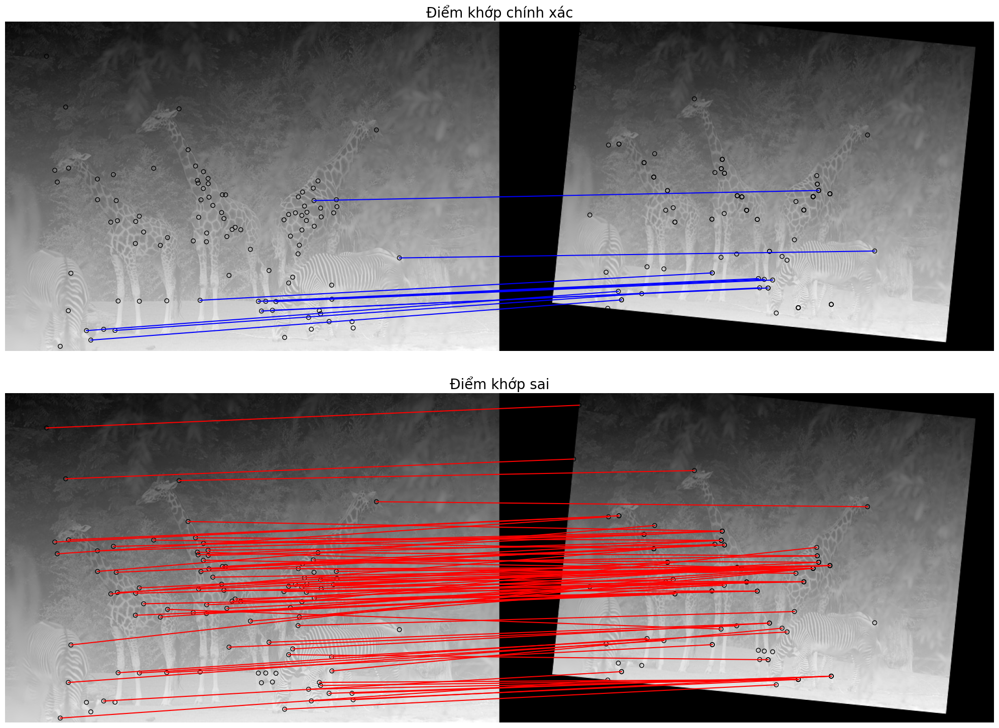

In [14]:
import numpy as np
import matplotlib.pyplot as plt
from skimage.io import imread
from skimage.color import rgb2gray
from skimage.util import img_as_float
from skimage.exposure import rescale_intensity
from skimage.transform import AffineTransform, warp
from skimage.feature import corner_harris, corner_peaks, corner_subpix, plot_matches
from skimage.measure import ransac

# Đọc và chuẩn bị ảnh
image_path = "/kaggle/input/data-btl-xla/images/giraffe_zebra.jpg"
temple = rgb2gray(img_as_float(imread(image_path)))

# Chuẩn bị ảnh gốc với gradient màu
image_original = np.zeros(list(temple.shape) + [3])
image_original[..., 0] = temple
gradient_row, gradient_col = (np.mgrid[0:image_original.shape[0],
                                       0:image_original.shape[1]] / float(image_original.shape[0]))
image_original[..., 1] = gradient_row
image_original[..., 2] = gradient_col
image_original = rescale_intensity(image_original)
image_original_gray = rgb2gray(image_original)

# Áp dụng biến đổi affine
affine_trans = AffineTransform(scale=(0.8, 0.9), rotation=0.1, translation=(120, -20))
image_warped = warp(image_original, affine_trans.inverse, output_shape=image_original.shape)
image_warped_gray = rgb2gray(image_warped)

# Phát hiện điểm góc với Harris Corner
coordinates = corner_harris(image_original_gray)
coordinates[coordinates > 0.01 * coordinates.max()] = 1
coordinates_original = corner_peaks(coordinates, threshold_rel=0.0001, min_distance=5)

coordinates = corner_harris(image_warped_gray)
coordinates[coordinates > 0.01 * coordinates.max()] = 1
coordinates_warped = corner_peaks(coordinates, threshold_rel=0.0001, min_distance=5)

# Định vị các góc sub-pixel
coordinates_original_subpix = corner_subpix(image_original_gray, coordinates_original, window_size=9)
coordinates_warped_subpix = corner_subpix(image_warped_gray, coordinates_warped, window_size=9)

# Hàm tính toán trọng số Gaussian
def gaussian_weights(window_ext, sigma=1):
    y, x = np.mgrid[-window_ext:window_ext+1, -window_ext:window_ext+1]
    g_w = np.exp(-0.5 * (x**2 / sigma**2 + y**2 / sigma**2))
    g_w /= 2 * np.pi * sigma * sigma
    return g_w

# Khớp điểm góc bằng phương pháp tổng bình phương sai số (SSD)
def match_corner(coordinates, window_ext=3):
    row, col = np.round(coordinates).astype(np.intp)
    window_original = image_original[row-window_ext:row+window_ext+1, col-window_ext:col+window_ext+1, :]
    weights = gaussian_weights(window_ext, 3)
    weights = np.dstack((weights, weights, weights))
    SSDs = []
    for coord_row, coord_col in coordinates_warped:
        window_warped = image_warped[coord_row-window_ext:coord_row+window_ext+1,
                                     coord_col-window_ext:coord_col+window_ext+1, :]
        if window_original.shape == window_warped.shape:
            SSD = np.sum(weights * (window_original - window_warped)**2)
            SSDs.append(SSD)
    min_idx = np.argmin(SSDs) if len(SSDs) > 0 else -1
    return coordinates_warped_subpix[min_idx] if min_idx >= 0 else [None]

# Xác định các điểm khớp
source, destination = [], []
for coordinates in coordinates_original_subpix:
    coordinates1 = match_corner(coordinates)
    if any(coordinates1) and len(coordinates1) > 0 and not all(np.isnan(coordinates1)):
        source.append(coordinates)
        destination.append(coordinates1)
source = np.array(source)
destination = np.array(destination)

# Ước lượng mô hình biến đổi affine
model = AffineTransform()
model.estimate(source, destination)

# Ước lượng với RANSAC
model_robust, inliers = ransac((source, destination), AffineTransform,
                               min_samples=3, residual_threshold=2, max_trials=100)
outliers = inliers == False

# So sánh mô hình biến đổi
print("Tham số biến đổi affine ban đầu:")
print(f"Scale: {affine_trans.scale}, Translation: {affine_trans.translation}, Rotation: {affine_trans.rotation}")

print("Mô hình biến đổi ước lượng:")
print(f"Scale: {model.scale}, Translation: {model.translation}, Rotation: {model.rotation}")

print("Mô hình biến đổi RANSAC:")
print(f"Scale: {model_robust.scale}, Translation: {model_robust.translation}, Rotation: {model_robust.rotation}")

# Hiển thị các điểm khớp đúng và sai
fig, axes = plt.subplots(nrows=2, ncols=1, figsize=(20, 15))
inlier_idxs = np.nonzero(inliers)[0]
plot_matches(axes[0], image_original_gray, image_warped_gray, source, destination,
             np.column_stack((inlier_idxs, inlier_idxs)), matches_color='b')
axes[0].axis('off')
axes[0].set_title('Điểm khớp chính xác', size=20)

outlier_idxs = np.nonzero(outliers)[0]
plot_matches(axes[1], image_original_gray, image_warped_gray, source, destination,
             np.column_stack((outlier_idxs, outlier_idxs)), matches_color='r')
axes[1].axis('off')
axes[1].set_title('Điểm khớp sai', size=20)

plt.tight_layout()
plt.show()


# Blob detectors với LoG, DoG, và DoH

Ảnh ban đầu 

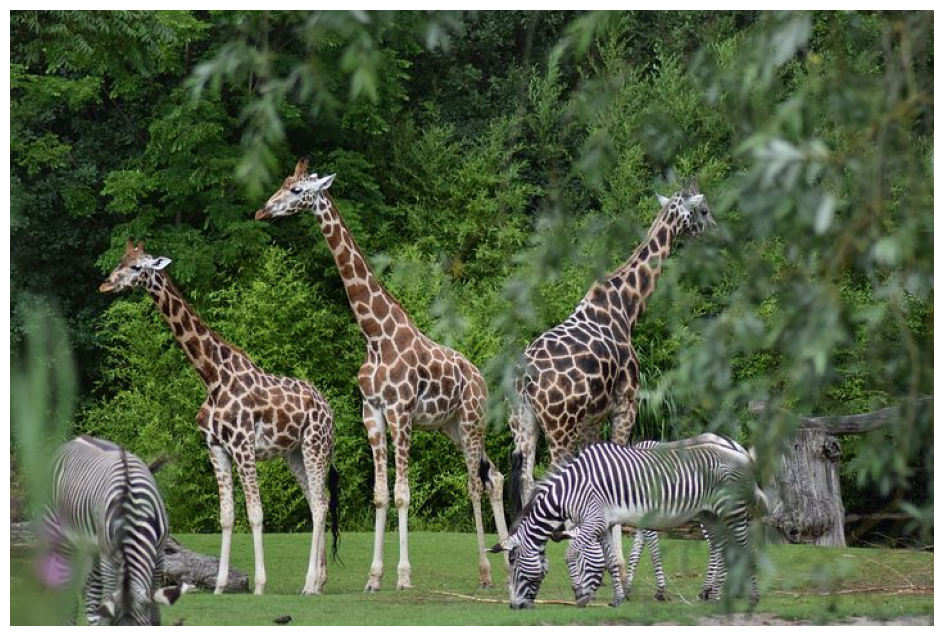

In [15]:
from PIL import Image
import matplotlib.pyplot as plt

# Đường dẫn đến bức ảnh đầu tiên
img_path = "/kaggle/input/data-btl-xla/images/giraffe_zebra.jpg"

# Mở ảnh 
img = Image.open(img_path)

# Tạo một cửa sổ hiển thị với kích thước lớn
plt.figure(figsize=(12, 8))

# Hiển thị bức ảnh 
plt.imshow(img)

# Tắt hiển thị trục tọa độ x và y để ảnh nhìn đẹp hơn
plt.axis('off')

# Hiển thị ảnh
plt.show()

Ảnh sau xử lý 

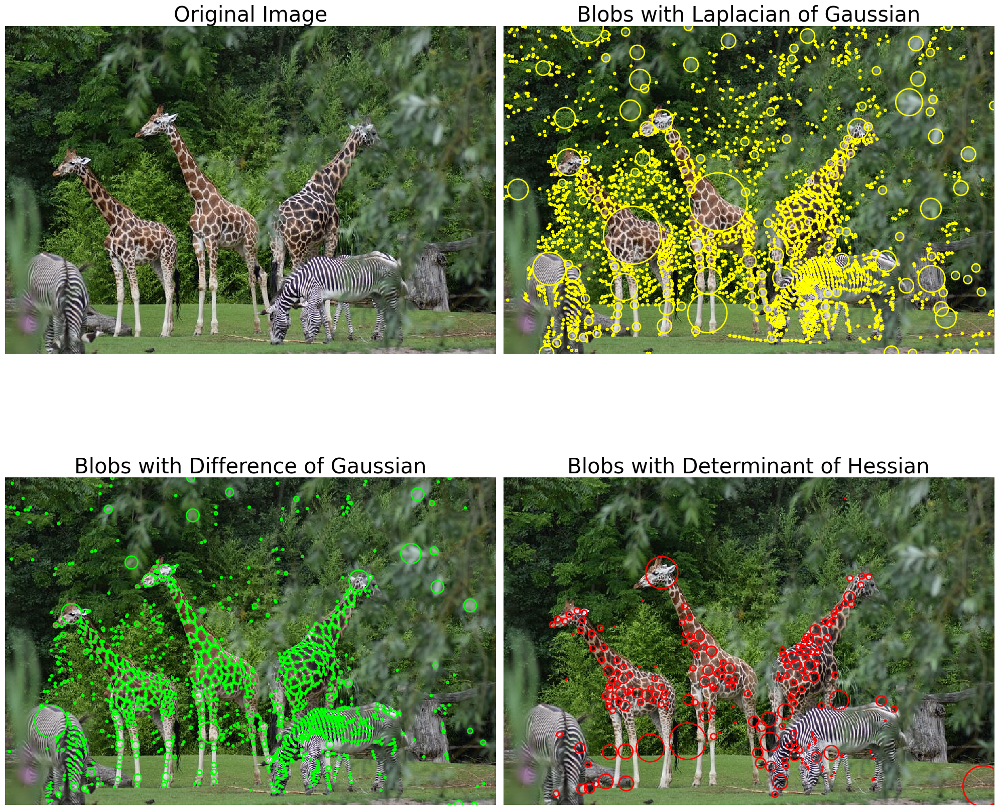

In [16]:
import numpy as np
import matplotlib.pyplot as plt
from skimage.io import imread
from skimage.color import rgb2gray
from skimage.feature import blob_dog, blob_log, blob_doh
from matplotlib.patches import Circle
from math import sqrt

# Đường dẫn đến bức ảnh
img_path = "/kaggle/input/data-btl-xla/images/giraffe_zebra.jpg"

# Đọc và chuyển ảnh sang grayscale
im = imread(img_path)
im_gray = rgb2gray(im)

# Phát hiện blob bằng 3 phương pháp khác nhau
log_blobs = blob_log(im_gray, max_sigma=30, num_sigma=10, threshold=.1)
log_blobs[:, 2] = sqrt(2) * log_blobs[:, 2]  # Tính bán kính từ cột thứ 3

dog_blobs = blob_dog(im_gray, max_sigma=30, threshold=0.1)
dog_blobs[:, 2] = sqrt(2) * dog_blobs[:, 2]

doh_blobs = blob_doh(im_gray, max_sigma=30, threshold=0.005)

# Lưu danh sách blobs và thông tin hiển thị
list_blobs = [log_blobs, dog_blobs, doh_blobs]
colors, titles = ['yellow', 'lime', 'red'], ['Laplacian of Gaussian', 'Difference of Gaussian', 'Determinant of Hessian']

# Hiển thị ảnh gốc và các blobs
fig, axes = plt.subplots(2, 2, figsize=(20, 20), sharex=True, sharey=True)
axes = axes.ravel()

# Hiển thị ảnh gốc
axes[0].imshow(im, interpolation='nearest')
axes[0].set_title('Original Image', size=30)
axes[0].axis('off')

# Hiển thị blobs với từng phương pháp phát hiện
for idx, (blobs, color, title) in enumerate(zip(list_blobs, colors, titles)):
    axes[idx + 1].imshow(im, interpolation='nearest')
    axes[idx + 1].set_title(f'Blobs with {title}', size=30)
    for blob in blobs:
        y, x, radius = blob
        col = Circle((x, y), radius, color=color, linewidth=2, fill=False)
        axes[idx + 1].add_patch(col)
    axes[idx + 1].axis('off')

plt.tight_layout()
plt.show()


# Histogram of Oriented Gradients

Ảnh ban đầu 

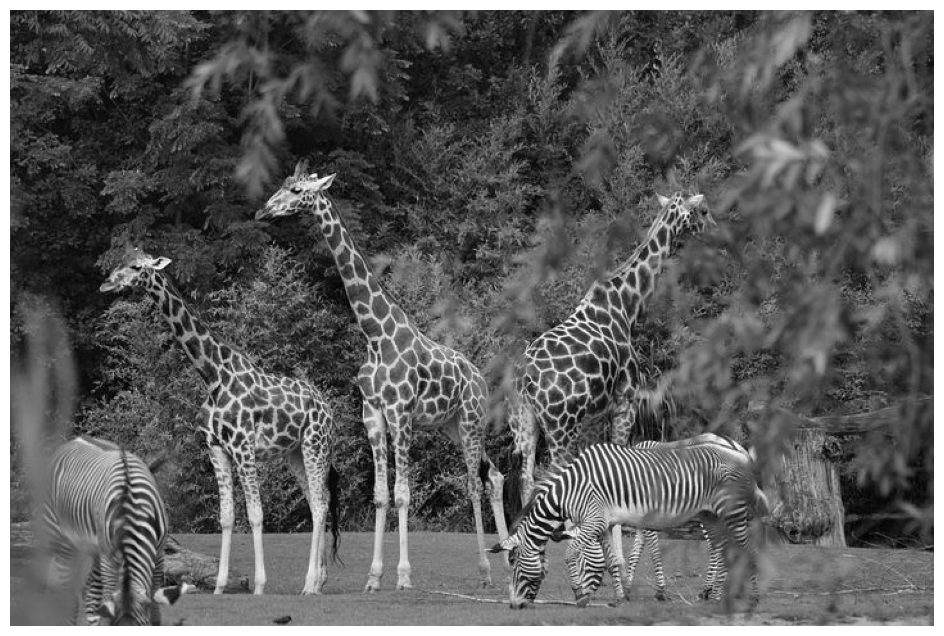

In [17]:
from PIL import Image
import matplotlib.pyplot as plt

# Đường dẫn đến bức ảnh đầu tiên
img_path = "/kaggle/input/data-btl-xla/images/giraffe_zebra.jpg"

# Mở ảnh và chuyển đổi thành ảnh grayscale
img = Image.open(img_path).convert('L')  # Chuyển thành ảnh xám

# Tạo một cửa sổ hiển thị với kích thước lớn
plt.figure(figsize=(12, 8))

# Hiển thị bức ảnh xám
plt.imshow(img, cmap='gray')  # Đặt `cmap='gray'` để hiển thị ảnh xám

# Tắt hiển thị trục tọa độ x và y để ảnh nhìn đẹp hơn
plt.axis('off')

# Hiển thị ảnh
plt.show()

Ảnh sau xử lý 

Image shape: (480, 720), Feature descriptor length: 10800


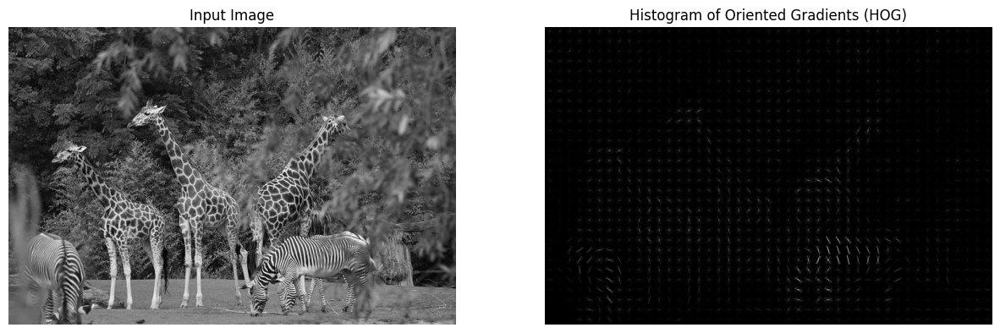

In [18]:
import matplotlib.pyplot as plt
from skimage.feature import hog
from skimage import exposure
from skimage.color import rgb2gray
from skimage.io import imread

# Đường dẫn đến ảnh
image_path = "/kaggle/input/data-btl-xla/images/giraffe_zebra.jpg"

# Đọc và chuyển đổi ảnh sang grayscale
image = rgb2gray(imread(image_path))

# Tính HOG và lấy ảnh HOG để hiển thị
fd, hog_image = hog(image, orientations=8, pixels_per_cell=(16, 16),
                    cells_per_block=(1, 1), visualize=True)

# In kích thước của ảnh và độ dài của đặc trưng HOG
print(f"Image shape: {image.shape}, Feature descriptor length: {len(fd)}")

# Tạo cửa sổ để hiển thị ảnh
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 10), sharex=True, sharey=True)

# Hiển thị ảnh gốc
ax1.axis('off')
ax1.imshow(image, cmap='gray')
ax1.set_title('Input Image')

# Rescale ảnh HOG để hiển thị rõ hơn và hiển thị
hog_image_rescaled = exposure.rescale_intensity(hog_image, in_range=(0, 10))
ax2.axis('off')
ax2.imshow(hog_image_rescaled, cmap='gray')
ax2.set_title('Histogram of Oriented Gradients (HOG)')

plt.show()


# Matching images with BRIEF binary descriptors

Ảnh ban đầu 

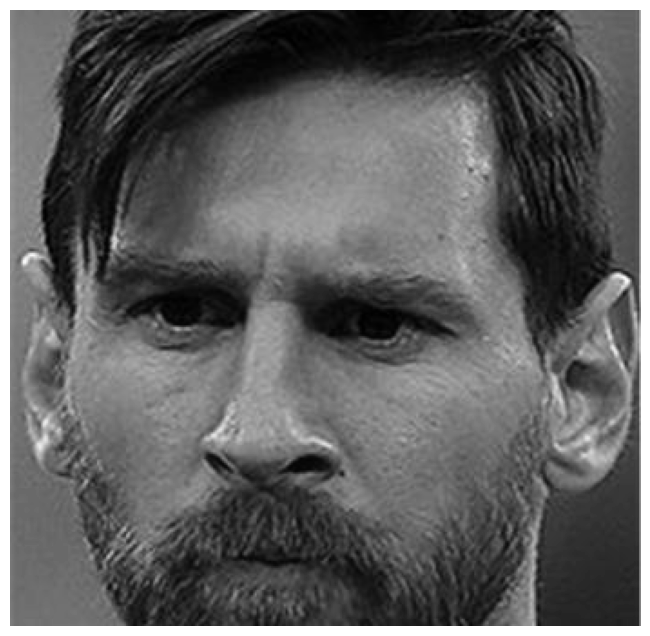

In [19]:
from PIL import Image
import matplotlib.pyplot as plt

# Đường dẫn đến bức ảnh đầu tiên
img_path = "/kaggle/input/data-btl-xla/images/messi.jpg"

# Mở ảnh và chuyển đổi thành ảnh grayscale
img = Image.open(img_path).convert('L')  # Chuyển thành ảnh xám

# Tạo một cửa sổ hiển thị với kích thước lớn
plt.figure(figsize=(12, 8))

# Hiển thị bức ảnh xám
plt.imshow(img, cmap='gray')  # Đặt `cmap='gray'` để hiển thị ảnh xám

# Tắt hiển thị trục tọa độ x và y để ảnh nhìn đẹp hơn
plt.axis('off')

# Hiển thị ảnh
plt.show()

Ảnh sau xử lý 

/tmp/ipykernel_30/722501951.py:47: FutureWarning: `plot_matches` is deprecated since version 0.23 and will be removed in version 0.25. Use `skimage.feature.plot_matched_features` instead.
  plot_matches(axes[0], img1, img2, keypoints1, keypoints2, matches12)
/tmp/ipykernel_30/722501951.py:51: FutureWarning: `plot_matches` is deprecated since version 0.23 and will be removed in version 0.25. Use `skimage.feature.plot_matched_features` instead.
  plot_matches(axes[1], img1, img3, keypoints1, keypoints3, matches13)


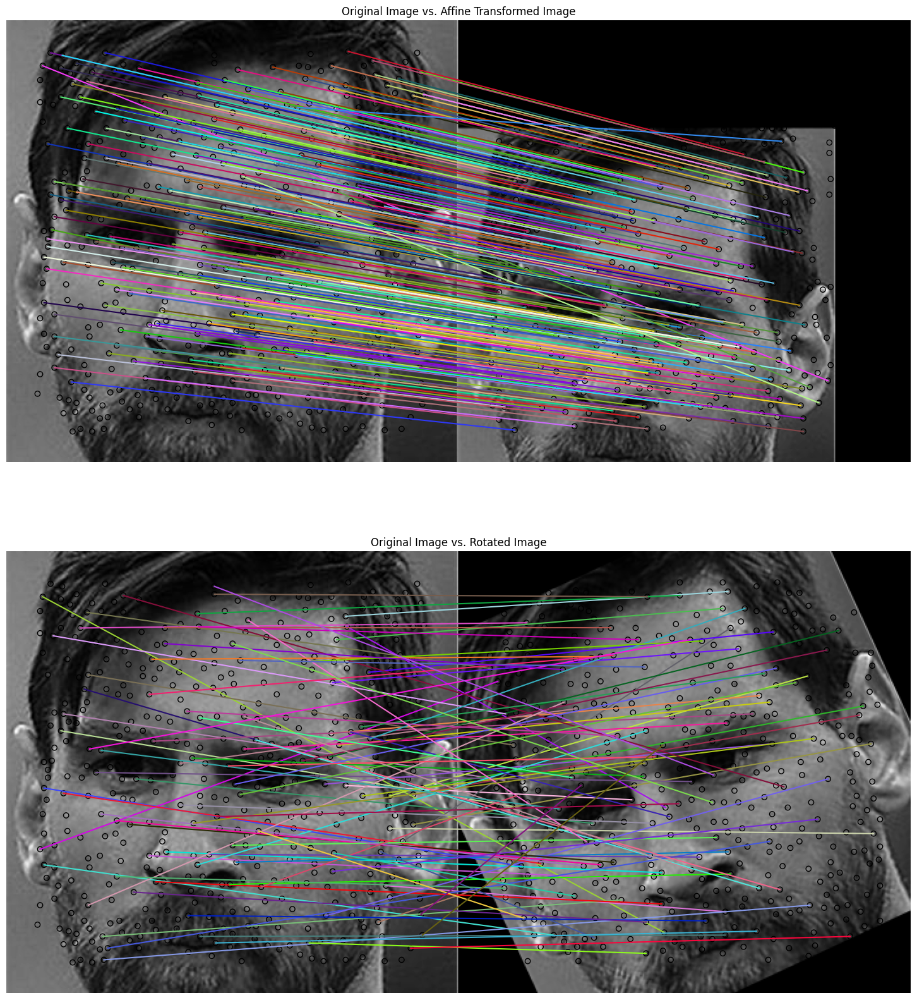

In [20]:
import matplotlib.pyplot as plt
from skimage import transform
from skimage.feature import match_descriptors, corner_peaks, corner_harris, plot_matches, BRIEF
from skimage.color import rgb2gray
from skimage.io import imread

# Đường dẫn đến ảnh
img1_path = "/kaggle/input/data-btl-xla/images/messi.jpg"

# Đọc và chuyển đổi ảnh sang grayscale
img1 = rgb2gray(imread(img1_path))

# Áp dụng biến đổi affine và xoay ảnh
affine_trans = transform.AffineTransform(scale=(1.2, 1.2), translation=(0, -100))
img2 = transform.warp(img1, affine_trans)
img3 = transform.rotate(img1, 25)

# Phát hiện điểm góc Harris trên ảnh gốc và các ảnh biến đổi
coords1, coords2, coords3 = corner_harris(img1), corner_harris(img2), corner_harris(img3)
coords1[coords1 > 0.01 * coords1.max()] = 1
coords2[coords2 > 0.01 * coords2.max()] = 1
coords3[coords3 > 0.01 * coords3.max()] = 1

keypoints1 = corner_peaks(coords1, min_distance=5)
keypoints2 = corner_peaks(coords2, min_distance=5)
keypoints3 = corner_peaks(coords3, min_distance=5)

# Trích xuất đặc trưng BRIEF từ các điểm góc
extractor = BRIEF()
extractor.extract(img1, keypoints1)
keypoints1, descriptors1 = keypoints1[extractor.mask], extractor.descriptors

extractor.extract(img2, keypoints2)
keypoints2, descriptors2 = keypoints2[extractor.mask], extractor.descriptors

extractor.extract(img3, keypoints3)
keypoints3, descriptors3 = keypoints3[extractor.mask], extractor.descriptors

# Khớp các đặc trưng giữa ảnh gốc và ảnh biến đổi
matches12 = match_descriptors(descriptors1, descriptors2, cross_check=True)
matches13 = match_descriptors(descriptors1, descriptors3, cross_check=True)

# Hiển thị các điểm khớp
fig, axes = plt.subplots(nrows=2, ncols=1, figsize=(20, 20))
plt.gray()

plot_matches(axes[0], img1, img2, keypoints1, keypoints2, matches12)
axes[0].axis('off')
axes[0].set_title("Original Image vs. Affine Transformed Image")

plot_matches(axes[1], img1, img3, keypoints1, keypoints3, matches13)
axes[1].axis('off')
axes[1].set_title("Original Image vs. Rotated Image")

plt.show()


# Matching with ORB features using brute-force matching

Ảnh ban đầu 

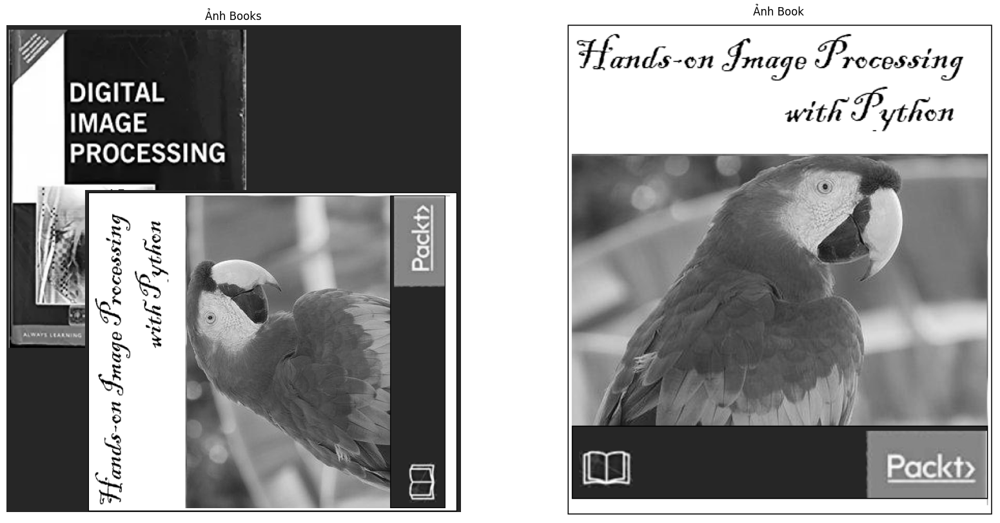

In [21]:
from PIL import Image
import matplotlib.pyplot as plt

# Đường dẫn đến các bức ảnh
img1_path = "/kaggle/input/data-btl-xla/images/books.png"  # Ảnh đầu tiên
img2_path = "/kaggle/input/data-btl-xla/images/book.png"   # Ảnh thứ hai

# Mở ảnh và chuyển đổi thành ảnh grayscale
img1 = Image.open(img1_path).convert('L')  # Chuyển `books.png` thành ảnh xám
img2 = Image.open(img2_path).convert('L')  # Chuyển `book.png` thành ảnh xám

# Tạo một cửa sổ hiển thị với kích thước lớn
plt.figure(figsize=(20, 10))

# Hiển thị ảnh đầu tiên
plt.subplot(1, 2, 1)  # Bố trí ảnh đầu tiên trên cửa sổ
plt.imshow(img1, cmap='gray')
plt.axis('off')
plt.title("Ảnh Books")

# Hiển thị ảnh thứ hai
plt.subplot(1, 2, 2)  # Bố trí ảnh thứ hai trên cửa sổ
plt.imshow(img2, cmap='gray')
plt.axis('off')
plt.title("Ảnh Book")

# Hiển thị cả hai ảnh
plt.show()


Ảnh sau xử lý 

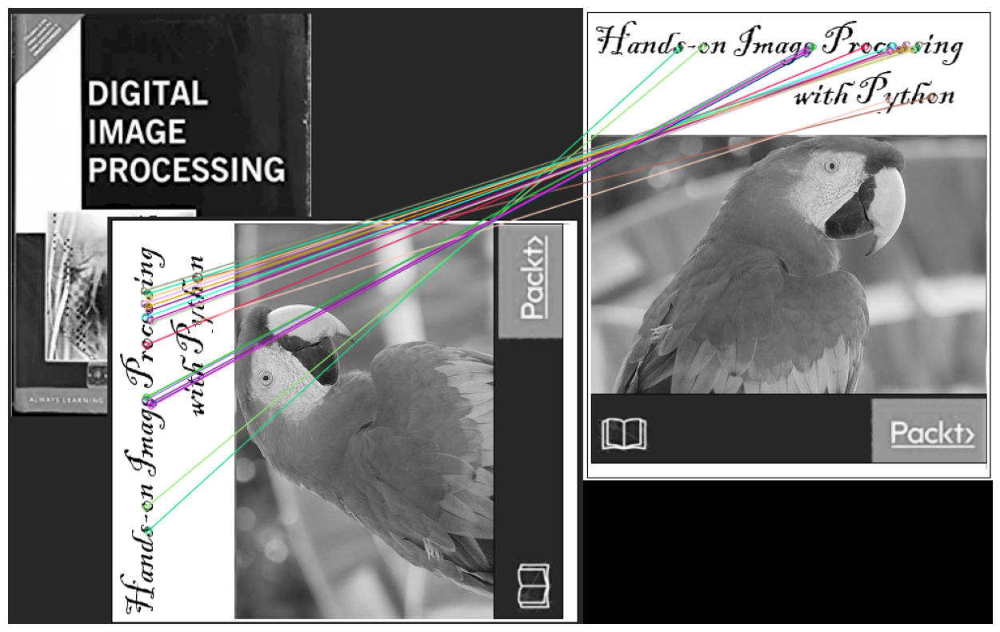

In [22]:
import cv2
import matplotlib.pyplot as plt

# Đường dẫn đến ảnh
img1_path = "/kaggle/input/data-btl-xla/images/books.png"  # queryImage
img2_path = "/kaggle/input/data-btl-xla/images/book.png"   # trainImage

# Đọc ảnh và chuyển sang grayscale
img1 = cv2.imread(img1_path, cv2.IMREAD_GRAYSCALE)
img2 = cv2.imread(img2_path, cv2.IMREAD_GRAYSCALE)

# Tạo đối tượng phát hiện ORB
orb = cv2.ORB_create()

# Tìm keypoints và descriptors
kp1, des1 = orb.detectAndCompute(img1, None)
kp2, des2 = orb.detectAndCompute(img2, None)

# Tạo đối tượng BFMatcher với chuẩn Hamming
bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)

# Khớp các descriptors
matches = bf.match(des1, des2)

# Sắp xếp các khớp dựa trên khoảng cách
matches = sorted(matches, key=lambda x: x.distance)

# Vẽ 20 khớp đầu tiên
img3 = cv2.drawMatches(img1, kp1, img2, kp2, matches[:20], None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

# Hiển thị kết quả
plt.figure(figsize=(20, 10))
plt.imshow(img3)
plt.axis('off')
plt.show()


# Brute-force matching with SIFT descriptors and ratio test

Ảnh ban đầu 

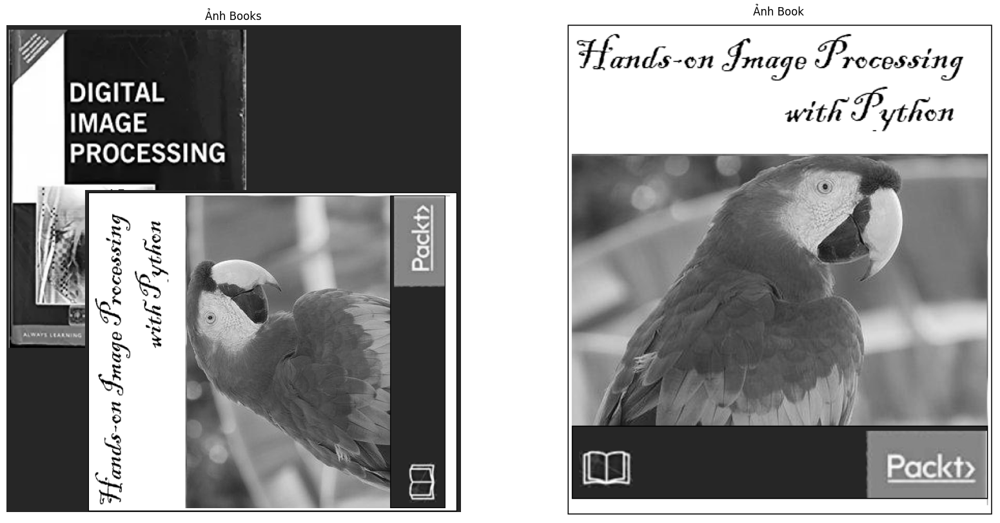

In [23]:
from PIL import Image
import matplotlib.pyplot as plt

# Đường dẫn đến các bức ảnh
img1_path = "/kaggle/input/data-btl-xla/images/books.png"  # Ảnh đầu tiên
img2_path = "/kaggle/input/data-btl-xla/images/book.png"   # Ảnh thứ hai

# Mở ảnh và chuyển đổi thành ảnh grayscale
img1 = Image.open(img1_path).convert('L')  # Chuyển `books.png` thành ảnh xám
img2 = Image.open(img2_path).convert('L')  # Chuyển `book.png` thành ảnh xám

# Tạo một cửa sổ hiển thị với kích thước lớn
plt.figure(figsize=(20, 10))

# Hiển thị ảnh đầu tiên
plt.subplot(1, 2, 1)  # Bố trí ảnh đầu tiên trên cửa sổ
plt.imshow(img1, cmap='gray')
plt.axis('off')
plt.title("Ảnh Books")

# Hiển thị ảnh thứ hai
plt.subplot(1, 2, 2)  # Bố trí ảnh thứ hai trên cửa sổ
plt.imshow(img2, cmap='gray')
plt.axis('off')
plt.title("Ảnh Book")

# Hiển thị cả hai ảnh
plt.show()


Ảnh sau xử lý 

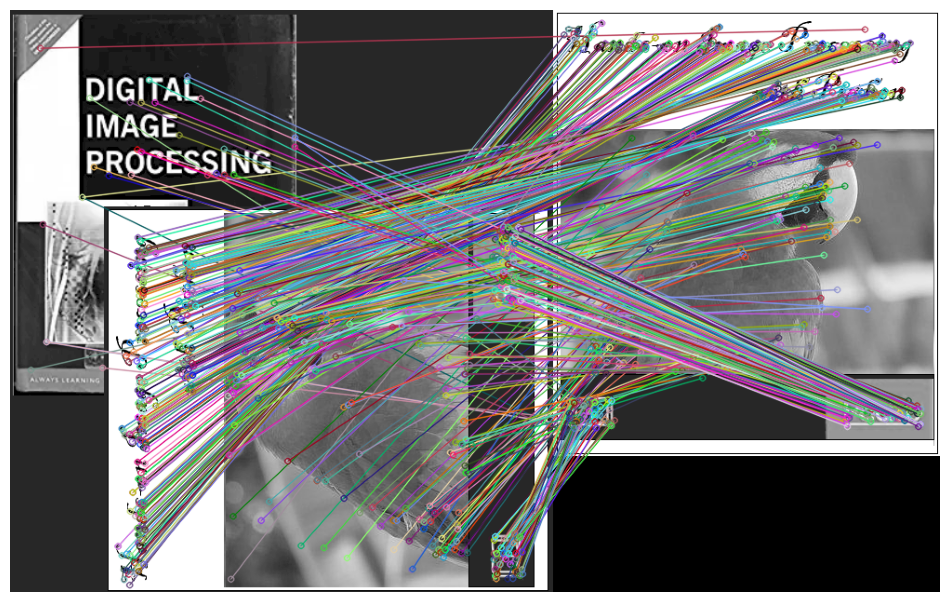

In [24]:
import cv2
import matplotlib.pyplot as plt

# Tải ảnh ở chế độ grayscale
img1 = cv2.imread('/kaggle/input/data-btl-xla/images/books.png', 0)  # queryImage
img2 = cv2.imread('/kaggle/input/data-btl-xla/images/book.png', 0)   # trainImage


# Tạo một đối tượng SIFT detector
sift = cv2.SIFT_create()

# Tìm các keypoint và descriptor với SIFT
kp1, des1 = sift.detectAndCompute(img1, None)
kp2, des2 = sift.detectAndCompute(img2, None)

# Sử dụng BFMatcher để khớp descriptor với KNN
bf = cv2.BFMatcher()
matches = bf.knnMatch(des1, des2, k=2)

# Áp dụng kiểm tra tỉ lệ để chọn các khớp tốt
good_matches = []
for m1, m2 in matches:
    if m1.distance < 0.75 * m2.distance:
        good_matches.append([m1])

# Vẽ các khớp nối
img3 = cv2.drawMatchesKnn(img1, kp1, img2, kp2, good_matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

# Hiển thị hình ảnh đã được nối khớp
plt.figure(figsize=(12, 8))
plt.imshow(img3, cmap='gray')
plt.axis('off')
plt.show()
